# POC Model: Medical Insurance Dataset (Regression)

# 1 Problem Statement

# 2 Data Gathering

In [1]:
import numpy as np
import pandas as pd

import seaborn as sns
import matplotlib.pyplot as plt

from statsmodels.stats.outliers_influence import variance_inflation_factor

from sklearn.model_selection import train_test_split, GridSearchCV, RandomizedSearchCV
from sklearn.linear_model import LinearRegression, Ridge, Lasso
from sklearn.neighbors import KNeighborsRegressor
from sklearn.tree import DecisionTreeRegressor, plot_tree
from sklearn.ensemble import RandomForestRegressor, AdaBoostRegressor
from sklearn.impute import KNNImputer
from sklearn.preprocessing import MinMaxScaler, StandardScaler

from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score

from scipy.stats import shapiro, kstest, normaltest, zscore, skew

import json
import pickle

import warnings
warnings.filterwarnings('ignore')

In [2]:
df=pd.read_csv("medical_insurance.csv")
df

,age,sex,bmi,children,smoker,region,charges
0,19,female,27.900,0,yes,southwest,16884.92400
1,18,male,33.770,1,no,southeast,1725.55230
2,28,male,33.000,3,no,southeast,4449.46200
3,33,male,22.705,0,no,northwest,21984.47061
4,32,male,28.880,0,no,northwest,3866.85520
...,...,...,...,...,...,...,...
1333,50,male,30.970,3,no,northwest,10600.54830
1334,18,female,31.920,0,no,northeast,2205.98080
1335,18,female,36.850,0,no,southeast,1629.83350
1336,21,female,25.800,0,no,southwest,2007.94500


# 3 Exploratory Data Analysis (EDA)

In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1338 entries, 0 to 1337
Data columns (total 7 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   age       1338 non-null   int64  
 1   sex       1338 non-null   object 
 2   bmi       1338 non-null   float64
 3   children  1338 non-null   int64  
 4   smoker    1338 non-null   object 
 5   region    1338 non-null   object 
 6   charges   1338 non-null   float64
dtypes: float64(2), int64(2), object(3)
memory usage: 73.3+ KB


In [4]:
df.isna().sum()
# There are no missing values

age         0
sex         0
bmi         0
children    0
smoker      0
region      0
charges     0
dtype: int64

In [5]:
# KNN_Imputer function for imputing NaN values in df,
# so convert first all missing values into NaN & in numerical format

def knn_imputer(df):
    """KNN_Imputer function for imputing NaN values in df """
    knn_imputer = KNNImputer(n_neighbors=5)
    array = knn_imputer.fit_transform(df)

    df = pd.DataFrame(array,index=df.index, columns=df.columns)
    return df

In [6]:
df.columns

Index(['age', 'sex', 'bmi', 'children', 'smoker', 'region', 'charges'], dtype='object')

## 3.1 age

In [7]:
df['age'].unique()

array([19, 18, 28, 33, 32, 31, 46, 37, 60, 25, 62, 23, 56, 27, 52, 30, 34,
       59, 63, 55, 22, 26, 35, 24, 41, 38, 36, 21, 48, 40, 58, 53, 43, 64,
       20, 61, 44, 57, 29, 45, 54, 49, 47, 51, 42, 50, 39], dtype=int64)

In [8]:
df['age'].value_counts()

18    69
19    68
50    29
51    29
47    29
46    29
45    29
20    29
48    29
52    29
22    28
49    28
54    28
53    28
21    28
26    28
24    28
25    28
28    28
27    28
23    28
43    27
29    27
30    27
41    27
42    27
44    27
31    27
40    27
32    26
33    26
56    26
34    26
55    26
57    26
37    25
59    25
58    25
36    25
38    25
35    25
39    25
61    23
60    23
63    23
62    23
64    22
Name: age, dtype: int64

# 3.2 sex

In [9]:
df['sex'].unique()

array(['female', 'male'], dtype=object)

In [10]:
dict(df['sex'].value_counts())

{'male': 676, 'female': 662}

In [11]:
# Here Catagorical data is ordinal and efficiently converting 
# into numerical by label encoding
df['sex'].replace({'male': 0, 'female': 1}, inplace=True)
df['sex'].info()

<class 'pandas.core.series.Series'>
RangeIndex: 1338 entries, 0 to 1337
Series name: sex
Non-Null Count  Dtype
--------------  -----
1338 non-null   int64
dtypes: int64(1)
memory usage: 10.6 KB


## 3.3 bmi

In [12]:
df['bmi'].unique()

array([27.9  , 33.77 , 33.   , 22.705, 28.88 , 25.74 , 33.44 , 27.74 ,
       29.83 , 25.84 , 26.22 , 26.29 , 34.4  , 39.82 , 42.13 , 24.6  ,
       30.78 , 23.845, 40.3  , 35.3  , 36.005, 32.4  , 34.1  , 31.92 ,
       28.025, 27.72 , 23.085, 32.775, 17.385, 36.3  , 35.6  , 26.315,
       28.6  , 28.31 , 36.4  , 20.425, 32.965, 20.8  , 36.67 , 39.9  ,
       26.6  , 36.63 , 21.78 , 30.8  , 37.05 , 37.3  , 38.665, 34.77 ,
       24.53 , 35.2  , 35.625, 33.63 , 28.   , 34.43 , 28.69 , 36.955,
       31.825, 31.68 , 22.88 , 37.335, 27.36 , 33.66 , 24.7  , 25.935,
       22.42 , 28.9  , 39.1  , 36.19 , 23.98 , 24.75 , 28.5  , 28.1  ,
       32.01 , 27.4  , 34.01 , 29.59 , 35.53 , 39.805, 26.885, 38.285,
       37.62 , 41.23 , 34.8  , 22.895, 31.16 , 27.2  , 26.98 , 39.49 ,
       24.795, 31.3  , 38.28 , 19.95 , 19.3  , 31.6  , 25.46 , 30.115,
       29.92 , 27.5  , 28.4  , 30.875, 27.94 , 35.09 , 29.7  , 35.72 ,
       32.205, 28.595, 49.06 , 27.17 , 23.37 , 37.1  , 23.75 , 28.975,
      

In [13]:
df['bmi'].value_counts()

32.300    13
28.310     9
30.495     8
30.875     8
31.350     8
          ..
46.200     1
23.800     1
44.770     1
32.120     1
30.970     1
Name: bmi, Length: 548, dtype: int64

## 3.4 children

In [14]:
df['children'].unique()

array([0, 1, 3, 2, 5, 4], dtype=int64)

In [15]:
df['children'].value_counts()

0    574
1    324
2    240
3    157
4     25
5     18
Name: children, dtype: int64

## 3.5 smoker

In [16]:
df['smoker'].unique()

array(['yes', 'no'], dtype=object)

In [17]:
dict(df['smoker'].value_counts())

{'no': 1064, 'yes': 274}

In [18]:
df['smoker'].replace({'no': 0, 'yes': 1},inplace=True)

## 3.6 region

In [19]:
df['region'].unique()

array(['southwest', 'southeast', 'northwest', 'northeast'], dtype=object)

In [20]:
df['region'].value_counts()

southeast    364
southwest    325
northwest    325
northeast    324
Name: region, dtype: int64

In [21]:
# Here Catagorical data is nominal and efficiently converting 
# into numerical by One-Hot encoding
df=pd.get_dummies(df,columns=['region'])
df

,age,sex,bmi,children,smoker,charges,region_northeast,region_northwest,region_southeast,region_southwest
0,19,1,27.900,0,1,16884.92400,0,0,0,1
1,18,0,33.770,1,0,1725.55230,0,0,1,0
2,28,0,33.000,3,0,4449.46200,0,0,1,0
3,33,0,22.705,0,0,21984.47061,0,1,0,0
4,32,0,28.880,0,0,3866.85520,0,1,0,0
...,...,...,...,...,...,...,...,...,...,...
1333,50,0,30.970,3,0,10600.54830,0,1,0,0
1334,18,1,31.920,0,0,2205.98080,1,0,0,0
1335,18,1,36.850,0,0,1629.83350,0,0,1,0
1336,21,1,25.800,0,0,2007.94500,0,0,0,1


## 3.7 charges (Target Feature)

In [22]:
df['charges'].unique()

array([16884.924 ,  1725.5523,  4449.462 , ...,  1629.8335,  2007.945 ,
       29141.3603])

In [23]:
df['charges'].value_counts()

1639.56310     2
16884.92400    1
29330.98315    1
2221.56445     1
19798.05455    1
              ..
7345.08400     1
26109.32905    1
28287.89766    1
1149.39590     1
29141.36030    1
Name: charges, Length: 1337, dtype: int64

# 4 Feature Engineering

In [24]:
# 1. Function for Outlier Detection by giving column name as argument

def detect_outlier(column):
    """IQR Method is used to detect Outliers and also finding the other parameters: 
           q1, q2, q3, mean, median, uppertail, lowertail, useful_data, outliers"""
    
    print('Boxplot before imputation:')
    sns.boxplot(x= df[column])
    plt.show(close=None)
    
    global q1,q2,q3,median,uppertail,lowertail,good_data,outliers 
        # so we can use them outside into the impute function

    q1= df[column].quantile(.25)
    q2= df[column].quantile(.50)
    q3= df[column].quantile(.75)
    IQR= q3-q1
    uppertail= q3 + 1.5 * IQR
    lowertail= q1 - 1.5 * IQR

    good_data = df.loc[(df[column] <= uppertail) & 
                       (df[column] >= lowertail),column]  # use 'and' condition for good data
    
    outliers = df.loc[(df[column] > uppertail) | 
                      (df[column] < lowertail),  column]  # use 'or' condition for outliers
    
    print("Outliers:\n",outliers)
    print('--------'*10)
    print(f"Other Parameters from good-data of feature '{column}':")
    print("1. Maximum value:",good_data.max()); print("2. Minimum value:",good_data.min())
    print("3. Uppertail value:",uppertail)    ; print("4. Lowertail value:",lowertail)
    print("5. Mean value:",good_data.mean())  ; print("6. Median value:",good_data.median())
    print(f"7. For Total datapoints: Q1= {q1}, Q2= {q2}, Q3= {q3}")

In [25]:
# 2. Function for impute the outlier by giving argument column name, 
# upper value for outliers beyond uppertail
# lower value for outliers below lowertail

def impute_outlier(column, upper=None, lower=None):
    
    """Imputing the outliers by max, min, uppertail, lowertail, mean, 
    median of good data(Uppertail to lowertail range) in upper & lower arguments"""
    
    if upper=='max':
        df.loc[(df[column] > uppertail), column] = good_data.max()
    if upper=='uppertail':
        df.loc[(df[column] > uppertail), column] = uppertail
    if upper=='mean':
        df.loc[(df[column] > uppertail), column] = good_data.mean() 
    if upper=='median':
        df.loc[(df[column] > uppertail), column] = good_data.median()
    if lower=='min':
        df.loc[(df[column] < lowertail), column] = good_data.min()
    if lower=='lowertail':
        df.loc[(df[column] < lowertail), column] = lowertail
    if lower=='mean':
        df.loc[(df[column] < lowertail), column] = good_data.mean()     
    if lower=='median':
        df.loc[(df[column] < lowertail), column] = good_data.median()
        
    print('Boxplot After Outlier imputation:')    
    sns.boxplot(x= df[column])
    plt.show(close=None)
    
    outliers1 = df.loc[(df[column] > uppertail) | 
                       (df[column] < lowertail),  column]   # use 'or' condition for outliers
    print("Outliers After Imputation:\n",outliers1)

In [26]:
df.columns

Index(['age', 'sex', 'bmi', 'children', 'smoker', 'charges',
       'region_northeast', 'region_northwest', 'region_southeast',
       'region_southwest'],
      dtype='object')

In [27]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1338 entries, 0 to 1337
Data columns (total 10 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   age               1338 non-null   int64  
 1   sex               1338 non-null   int64  
 2   bmi               1338 non-null   float64
 3   children          1338 non-null   int64  
 4   smoker            1338 non-null   int64  
 5   charges           1338 non-null   float64
 6   region_northeast  1338 non-null   uint8  
 7   region_northwest  1338 non-null   uint8  
 8   region_southeast  1338 non-null   uint8  
 9   region_southwest  1338 non-null   uint8  
dtypes: float64(2), int64(4), uint8(4)
memory usage: 68.1 KB


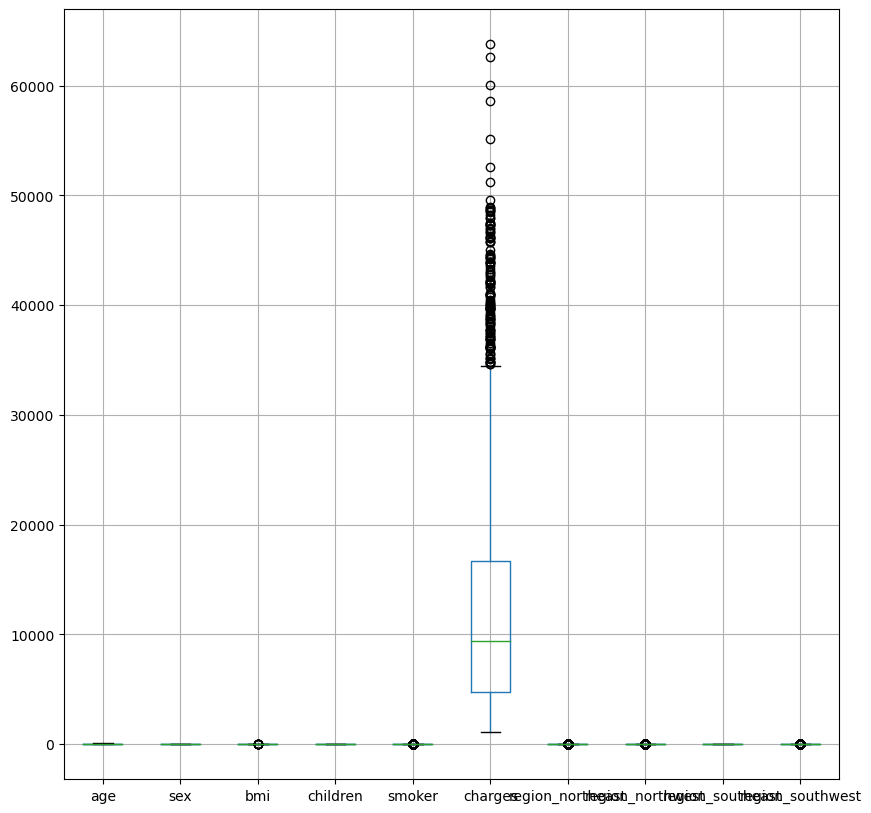

In [28]:
df.boxplot(figsize=(10,10))
plt.show(close=None)

## 4.1 age

Boxplot before imputation:


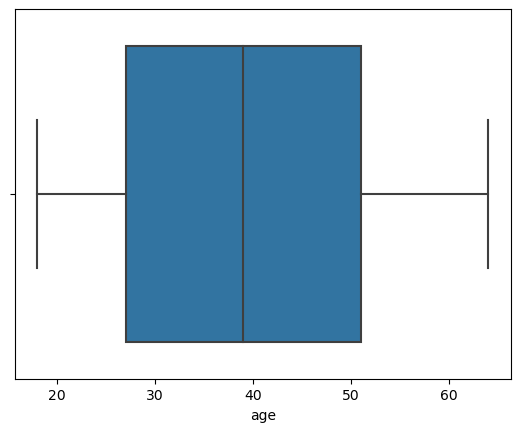

Outliers:
 Series([], Name: age, dtype: int64)
--------------------------------------------------------------------------------
Other Parameters from good-data of feature 'age':
1. Maximum value: 64
2. Minimum value: 18
3. Uppertail value: 87.0
4. Lowertail value: -9.0
5. Mean value: 39.20702541106129
6. Median value: 39.0
7. For Total datapoints: Q1= 27.0, Q2= 39.0, Q3= 51.0


In [29]:
detect_outlier("age")

In [30]:
# There are no outliers in 'age' feature

## 4.2 sex

Boxplot before imputation:


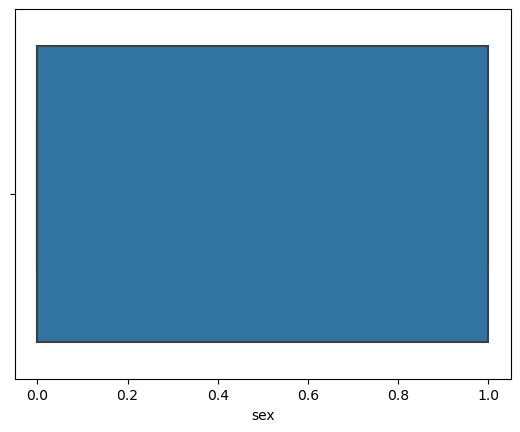

Outliers:
 Series([], Name: sex, dtype: int64)
--------------------------------------------------------------------------------
Other Parameters from good-data of feature 'sex':
1. Maximum value: 1
2. Minimum value: 0
3. Uppertail value: 2.5
4. Lowertail value: -1.5
5. Mean value: 0.4947683109118087
6. Median value: 0.0
7. For Total datapoints: Q1= 0.0, Q2= 0.0, Q3= 1.0


In [31]:
detect_outlier('sex')

In [32]:
# There are no outliers in 'sex' feature as it is binary categorical data

## 4.3 bmi

Boxplot before imputation:


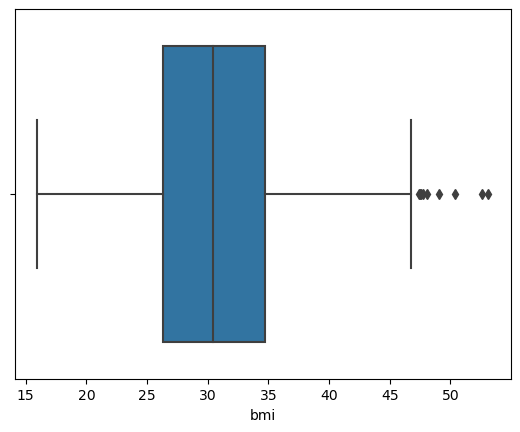

Outliers:
 116     49.06
286     48.07
401     47.52
543     47.41
847     50.38
860     47.60
1047    52.58
1088    47.74
1317    53.13
Name: bmi, dtype: float64
--------------------------------------------------------------------------------
Other Parameters from good-data of feature 'bmi':
1. Maximum value: 46.75
2. Minimum value: 15.96
3. Uppertail value: 47.290000000000006
4. Lowertail value: 13.7
5. Mean value: 30.53734762979683
6. Median value: 30.3
7. For Total datapoints: Q1= 26.29625, Q2= 30.4, Q3= 34.69375


In [33]:
detect_outlier('bmi')

In [34]:
# Here outliers are detected on upper side only as per boxplot
# Now imputing them as max value of good data on upper side 
# and min value of good data on lower side

Boxplot After Outlier imputation:


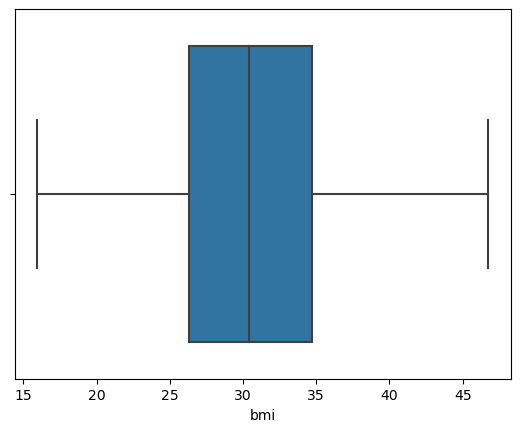

Outliers After Imputation:
 Series([], Name: bmi, dtype: float64)


In [35]:
impute_outlier('bmi','max','min')

In [36]:
# After inputation there are no outliers in 'bmi' feature

## 4.4 children

Boxplot before imputation:


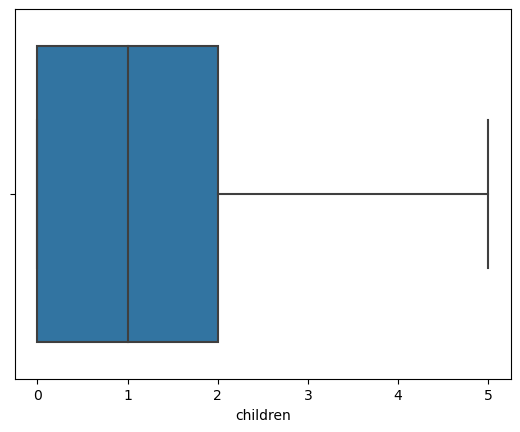

Outliers:
 Series([], Name: children, dtype: int64)
--------------------------------------------------------------------------------
Other Parameters from good-data of feature 'children':
1. Maximum value: 5
2. Minimum value: 0
3. Uppertail value: 5.0
4. Lowertail value: -3.0
5. Mean value: 1.0949177877429
6. Median value: 1.0
7. For Total datapoints: Q1= 0.0, Q2= 1.0, Q3= 2.0


In [37]:
detect_outlier('children')

In [38]:
# There are no outliers in 'children' feature

## 4.5 smoker

Boxplot before imputation:


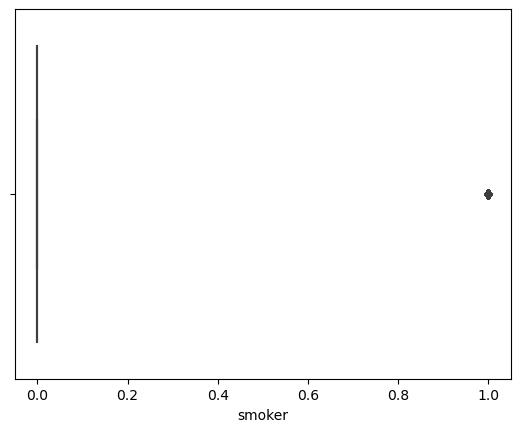

Outliers:
 0       1
11      1
14      1
19      1
23      1
       ..
1313    1
1314    1
1321    1
1323    1
1337    1
Name: smoker, Length: 274, dtype: int64
--------------------------------------------------------------------------------
Other Parameters from good-data of feature 'smoker':
1. Maximum value: 0
2. Minimum value: 0
3. Uppertail value: 0.0
4. Lowertail value: 0.0
5. Mean value: 0.0
6. Median value: 0.0
7. For Total datapoints: Q1= 0.0, Q2= 0.0, Q3= 0.0


In [39]:
detect_outlier('smoker')

In [40]:
# There are no outliers in 'smoker' feature as it is binary categorical data

## 4.6 charges

Boxplot before imputation:


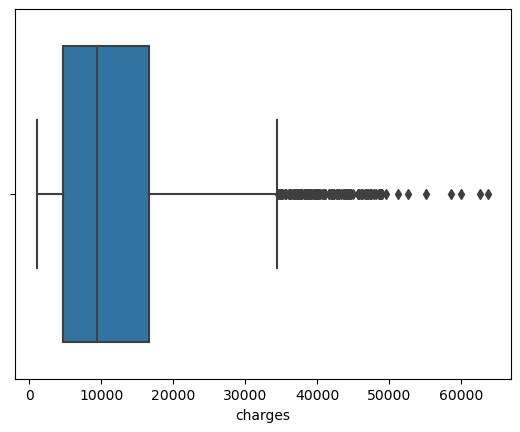

Outliers:
 14      39611.75770
19      36837.46700
23      37701.87680
29      38711.00000
30      35585.57600
           ...     
1300    62592.87309
1301    46718.16325
1303    37829.72420
1313    36397.57600
1323    43896.37630
Name: charges, Length: 139, dtype: float64
--------------------------------------------------------------------------------
Other Parameters from good-data of feature 'charges':
1. Maximum value: 34472.841
2. Minimum value: 1121.8739
3. Uppertail value: 34489.350562499996
4. Lowertail value: -13109.1508975
5. Mean value: 9927.753402125936
6. Median value: 8410.04685
7. For Total datapoints: Q1= 4740.28715, Q2= 9382.033, Q3= 16639.912515


In [41]:
detect_outlier('charges')

In [42]:
# There are chances of outlier values may be correct

In [43]:
df

,age,sex,bmi,children,smoker,charges,region_northeast,region_northwest,region_southeast,region_southwest
0,19,1,27.900,0,1,16884.92400,0,0,0,1
1,18,0,33.770,1,0,1725.55230,0,0,1,0
2,28,0,33.000,3,0,4449.46200,0,0,1,0
3,33,0,22.705,0,0,21984.47061,0,1,0,0
4,32,0,28.880,0,0,3866.85520,0,1,0,0
...,...,...,...,...,...,...,...,...,...,...
1333,50,0,30.970,3,0,10600.54830,0,1,0,0
1334,18,1,31.920,0,0,2205.98080,1,0,0,0
1335,18,1,36.850,0,0,1629.83350,0,0,1,0
1336,21,1,25.800,0,0,2007.94500,0,0,0,1


# 5 Feature Selection

### 1. Linearity

In [44]:
# Here we are checking coef. of correlation (r) of 
# independent feature with dependent feature

correlation=df.corr()[['charges']].T
correlation

,age,sex,bmi,children,smoker,charges,region_northeast,region_northwest,region_southeast,region_southwest
charges,0.299008,-0.057292,0.198895,0.067998,0.787251,1.0,0.006349,-0.039905,0.073982,-0.04321


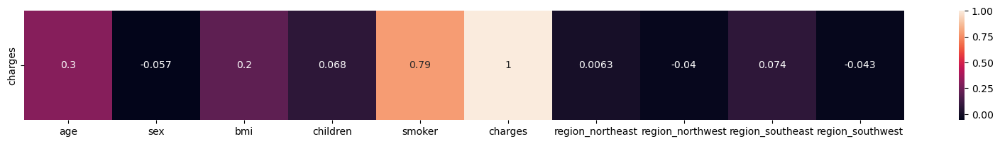

In [45]:
plt.figure(figsize=(20,2))
sns.heatmap(correlation,annot=True)
plt.show(close=None)

### 2 No-Multicolinearity

,VIF_Factor
age,1.017498
sex,1.008745
bmi,1.106323
children,1.004037
smoker,1.012089
region_northeast,8.881752
region_northwest,8.928913
region_southeast,11.862706
region_southwest,9.516949


 None


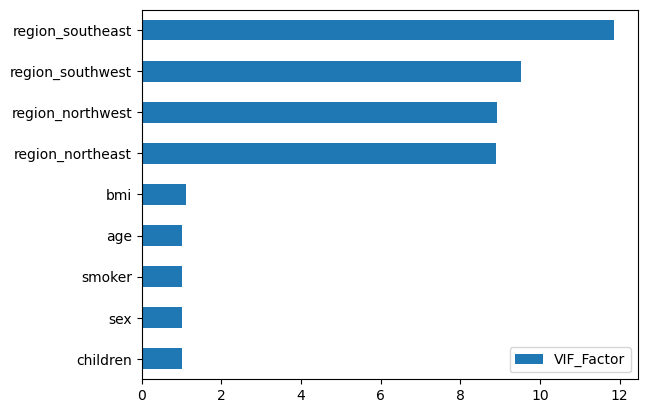

In [46]:
vif_factors_list=[]
x=df.drop(['charges'], axis=1)
for i in range(len(x.columns)):
    vif=variance_inflation_factor(x,i)
    vif_factors_list.append(vif)
vif_factors=pd.DataFrame(vif_factors_list, index=x.columns, columns=['VIF_Factor'])
print("",display(vif_factors))
vif_factors.sort_values(['VIF_Factor']).plot(kind = 'barh')
plt.show(close=False)

# 6 Model Building

###  Spliting the Dataset

In [47]:
x=df.drop(['charges'], axis=1)
y=df['charges']

x_train,x_test,y_train,y_test=train_test_split(x,y, test_size=0.25, random_state=13)

# [1] Linear Regression Algorithm

In [48]:
# creating instance & model fitting
linear_model=LinearRegression()

linear_model.fit(x_train, y_train)

LinearRegression()

In [49]:
linear_model.coef_

array([ 2.54914980e+02,  1.20531832e+01,  3.65265411e+02,  5.25078446e+02,
        2.37148199e+04,  4.76139886e+02,  2.67424848e+02, -3.89913512e+02,
       -3.53651222e+02])

In [50]:
linear_model.intercept_

-13136.227861818828

### Model Evaluation of Linear Regression

In [51]:
# Evaluation of Training Data
y_pred_train=linear_model.predict(x_train)

mse=mean_squared_error(y_train,y_pred_train)
print("MSE=",mse)

rmse=np.sqrt(mse)
print("RMSE=",rmse)

mae=mean_absolute_error(y_train,y_pred_train)
print("MAE=",mae)

r2_train_linear_model=r2_score(y_train,y_pred_train)
print("R2 Score=",r2_train_linear_model)

MSE= 39057539.30369026
RMSE= 6249.603131694865
MAE= 4424.10709321285
R2 Score= 0.7379412766599166


In [52]:
# Evaluation of Testing Data
y_pred_test=linear_model.predict(x_test)

mse=mean_squared_error(y_test,y_pred_test)
print("MSE=",mse)

rmse=np.sqrt(mse)
print("RMSE=",rmse)

mae=mean_absolute_error(y_test,y_pred_test)
print("MAE=",mae)

r2_test_linear_model=r2_score(y_test,y_pred_test)
print("R2 Score=",r2_test_linear_model)

MSE= 29113513.303768363
RMSE= 5395.693959424345
MAE= 3853.4976533054673
R2 Score= 0.7874794585241002


## Normality of Residuals

In [53]:
Residuals_train=y_train-y_pred_train

### 3.1 KDE Plot

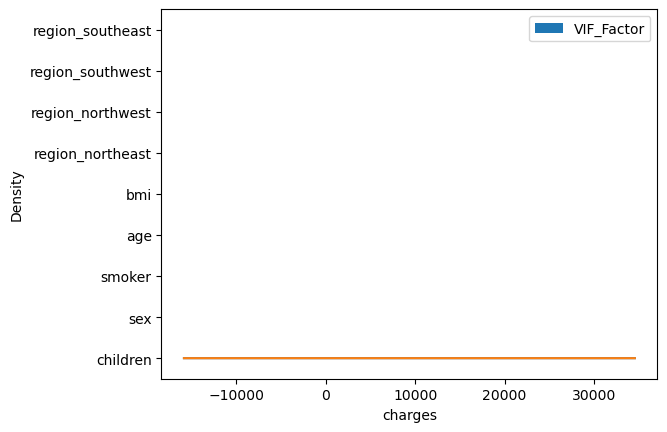

In [54]:
sns.kdeplot(Residuals_train)
sns.kdeplot(Residuals_train)
plt.show()

In [55]:
skewness=skew(Residuals_train)
skewness

1.1841604720381564

### 3.2 Hypothesis Testing

###### >>> Assuming that the Null Hypothesis, so checking for that:

#### 3.2.1 Shapiro Test

In [56]:
_,p_val=shapiro(Residuals_train)
print("P_Value:",p_val)
if p_val >= 0.05:
    print("Null Hypothesis is Accepted")
    print("--> Data is Normally Distributed")
    
else:
    print("Null Hypothesis is Rejected >> Alternate Hypothesis is Accepted")
    print("--> Data is NOT Normally Distributed")

P_Value: 2.4518753428116627e-24
Null Hypothesis is Rejected >> Alternate Hypothesis is Accepted
--> Data is NOT Normally Distributed


#### 3.2.2 KS Test

In [57]:
_,p_val=kstest(Residuals_train, 'norm')
print("P_Value:",p_val)
if p_val >= 0.05:
    print("Null Hypothesis is Accepted")
    print("--> Data is Normally Distributed")
    
else:
    print("Null Hypothesis is Rejected >> Alternate Hypothesis is Accepted")
    print("--> Data is NOT Normally Distributed")

P_Value: 0.0
Null Hypothesis is Rejected >> Alternate Hypothesis is Accepted
--> Data is NOT Normally Distributed


#### 3.2.3 Normal Test

In [58]:
_,p_val=normaltest(Residuals_train)
print("P_Value:",p_val)
if p_val >= 0.05:
    print("Null Hypothesis is Accepted")
    print("--> Data is Normally Distributed")
    
else:
    print("Null Hypothesis is Rejected >> Alternate Hypothesis is Accepted")
    print("--> Data is NOT Normally Distributed")

P_Value: 1.9151835745236504e-46
Null Hypothesis is Rejected >> Alternate Hypothesis is Accepted
--> Data is NOT Normally Distributed


### 3.3 Q-Q Plot

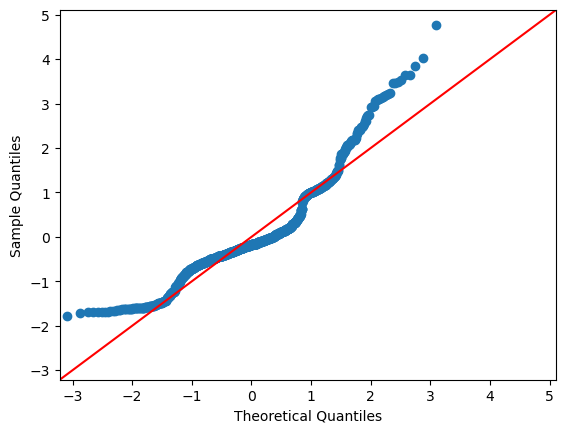

In [59]:
import statsmodels.api as sm
sm.qqplot(Residuals_train, line='45', fit=True)
plt.show()

In [60]:
# From the above tests conclude that data in not normally distributed

## 4 Homoscedasticity

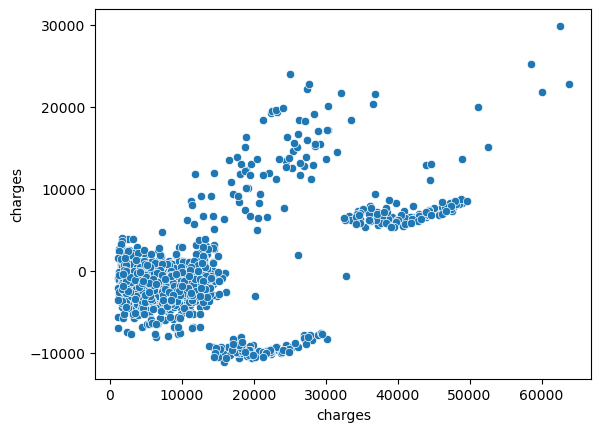

In [61]:
sns.scatterplot(x=y_train, y=Residuals_train)
plt.show()

### Now we are compare Linear Model's results with Ridge, Lasso and Hypperparameter Tuning for Ridge(Grid & Randomised) & Lasso(Grid & Randomised).

## 6.2 Ridge Regression Model

In [62]:
# Create Instance
ridge_model=Ridge(alpha=1.0)        # alpha=1.0 bydefault in Ridge and Lasso
ridge_model

# Model Fitting
ridge_model.fit(x_train,y_train)

Ridge()

In [63]:
ridge_model.coef_

array([ 2.54788357e+02,  3.49189311e+00,  3.64960137e+02,  5.24623331e+02,
        2.35710528e+04,  4.74322056e+02,  2.64215378e+02, -3.81469544e+02,
       -3.57067890e+02])

In [64]:
ridge_model.intercept_

-13087.195729652503

### Model Evaluation of Ridge Regression

In [65]:
# Evaluation of Training Data
y_pred_train=ridge_model.predict(x_train)

mse=mean_squared_error(y_train,y_pred_train)
print("MSE=",mse)

rmse=np.sqrt(mse)
print("RMSE=",rmse)

mae=mean_absolute_error(y_train,y_pred_train)
print("MAE=",mae)

r2_train_ridge_model=r2_score(y_train,y_pred_train)
print("R2 Score=",r2_train_ridge_model)

MSE= 39060922.02222714
RMSE= 6249.873760503258
MAE= 4435.470953481949
R2 Score= 0.7379185801225259


In [66]:
# Evaluation of Testing Data
y_pred_test=ridge_model.predict(x_test)

mse=mean_squared_error(y_test,y_pred_test)
print("MSE=",mse)

rmse=np.sqrt(mse)
print("RMSE=",rmse)

mae=mean_absolute_error(y_test,y_pred_test)
print("MAE=",mae)

r2_test_ridge_model=r2_score(y_test,y_pred_test)
print("R2 Score=",r2_test_ridge_model)

MSE= 29142454.735008962
RMSE= 5398.375193982812
MAE= 3864.4202377054785
R2 Score= 0.7872681941337751


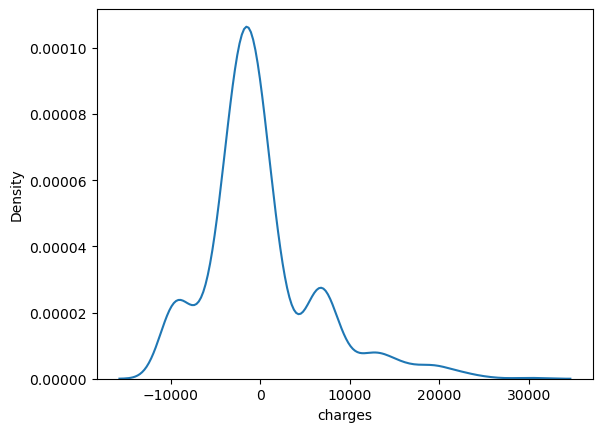

In [67]:
sns.kdeplot(y_train-y_pred_train)
plt.show()

## 6.3 Lasso Regression Model (L2 Regularisation)

In [68]:
# Create Instance
lasso_model=Lasso(alpha=1.0)        # alpha=1.0 bydefault in Ridge and Lasso
lasso_model

# Model Fitting
lasso_model.fit(x_train,y_train)

Lasso()

In [69]:
lasso_model.coef_

array([ 2.54927519e+02,  7.51715533e+00,  3.65023024e+02,  5.24418105e+02,
        2.37081618e+04,  7.41179097e+02,  5.32365482e+02, -1.15921407e+02,
       -8.03309407e+01])

In [70]:
lasso_model.intercept_

-13394.40366296611

### Model Evaluation of Lasso Regression (L1 Regularisation)

In [71]:
# Evaluation of Training Data
y_pred_train=lasso_model.predict(x_train)

mse=mean_squared_error(y_train,y_pred_train)
print("MSE=",mse)

rmse=np.sqrt(mse)
print("RMSE=",rmse)

mae=mean_absolute_error(y_train,y_pred_train)
print("MAE=",mae)

r2_train_lasso_model=r2_score(y_train,y_pred_train)
print("R2 Score=",r2_train_lasso_model)

MSE= 39057568.73251372
RMSE= 6249.605486149803
MAE= 4424.418316399921
R2 Score= 0.7379410792055956


In [72]:
# Evaluation of Testing Data
y_pred_test=lasso_model.predict(x_test)

mse=mean_squared_error(y_test,y_pred_test)
print("MSE=",mse)

rmse=np.sqrt(mse)
print("RMSE=",rmse)

mae=mean_absolute_error(y_test,y_pred_test)
print("MAE=",mae)

r2_test_lasso_model=r2_score(y_test,y_pred_test)
print("R2 Score=",r2_test_lasso_model)

MSE= 29116033.457076512
RMSE= 5395.927488122548
MAE= 3853.752024884321
R2 Score= 0.7874610621065994


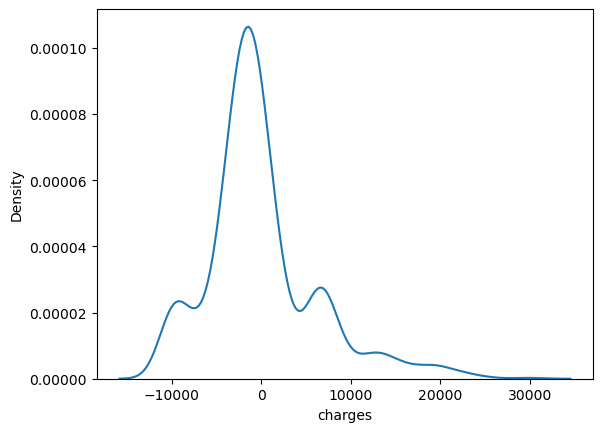

In [73]:
sns.kdeplot(y_train-y_pred_train)
plt.show()

## 6.4 Hyperparameter Tunning

## 6.4.1 Hyperparameter Tunning for Ridge Regression Model 

### 6.4.1.1 GridSearchCV in Ridge Regression Model

In [74]:
# Defined param_grid
param_grid = {"alpha": np.arange(0.01,3,0.01),
             'random_state': np.arange(0,20)}

# Create Instance
gscv_ridge_model=GridSearchCV(ridge_model,
                              param_grid,
                              scoring=None,
                              n_jobs=-1,
                              refit=True,
                              cv=9,
                              verbose=0,
                              pre_dispatch='2*n_jobs',
                              return_train_score=False)
# Model Fitting on gscv
gscv_ridge_model.fit(x_train,y_train)

GridSearchCV(cv=9, estimator=Ridge(), n_jobs=-1,
             param_grid={'alpha': array([0.01, 0.02, 0.03, 0.04, 0.05, 0.06, 0.07, 0.08, 0.09, 0.1 , 0.11,
       0.12, 0.13, 0.14, 0.15, 0.16, 0.17, 0.18, 0.19, 0.2 , 0.21, 0.22,
       0.23, 0.24, 0.25, 0.26, 0.27, 0.28, 0.29, 0.3 , 0.31, 0.32, 0.33,
       0.34, 0.35, 0.36, 0.37, 0.38, 0.39, 0.4 , 0.41, 0.42, 0.43, 0.44,
       0.45, 0.46, 0.47, 0.48, 0.49, 0.5 , 0.51, 0.52, 0.53, 0.54, 0.55,
       0.56, 0....
       2.43, 2.44, 2.45, 2.46, 2.47, 2.48, 2.49, 2.5 , 2.51, 2.52, 2.53,
       2.54, 2.55, 2.56, 2.57, 2.58, 2.59, 2.6 , 2.61, 2.62, 2.63, 2.64,
       2.65, 2.66, 2.67, 2.68, 2.69, 2.7 , 2.71, 2.72, 2.73, 2.74, 2.75,
       2.76, 2.77, 2.78, 2.79, 2.8 , 2.81, 2.82, 2.83, 2.84, 2.85, 2.86,
       2.87, 2.88, 2.89, 2.9 , 2.91, 2.92, 2.93, 2.94, 2.95, 2.96, 2.97,
       2.98, 2.99]),
                         'random_state': array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
       17, 18, 19])})

In [75]:
gscv_ridge_model.best_estimator_

Ridge(alpha=2.3699999999999997, random_state=0)

#### Model Evaluation of GridSearchCV Ridge Regression 

In [76]:
# Evaluation of Training Data
y_pred_train=gscv_ridge_model.predict(x_train)

mse=mean_squared_error(y_train,y_pred_train)
print("MSE=",mse)

rmse=np.sqrt(mse)
print("RMSE=",rmse)

mae=mean_absolute_error(y_train,y_pred_train)
print("MAE=",mae)

r2_train_gscv_ridge_model=r2_score(y_train,y_pred_train)
print("R2 Score=",r2_train_gscv_ridge_model)

MSE= 39076225.85453592
RMSE= 6251.097971919487
MAE= 4450.867864315998
R2 Score= 0.7378158982119768


In [77]:
# Evaluation of Testing Data
y_pred_test=gscv_ridge_model.predict(x_test)

mse=mean_squared_error(y_test,y_pred_test)
print("MSE=",mse)

rmse=np.sqrt(mse)
print("RMSE=",rmse)

mae=mean_absolute_error(y_test,y_pred_test)
print("MAE=",mae)

r2_test_gscv_ridge_model=r2_score(y_test,y_pred_test)
print("R2 Score=",r2_test_gscv_ridge_model)

MSE= 29191580.9828202
RMSE= 5402.923373769075
MAE= 3879.3624359871346
R2 Score= 0.7869095862022422


## 6.4.2 Hyperparameter Tunning for Lasso Regression Model 

### 6.4.2.1 GridSearchCV in Lasso Regression Model

In [78]:
# Defined param_grid
param_grid = {"alpha": np.arange(0.01,3,0.01),
             'random_state':np.arange(0,20)}
# Create Instance
gscv_lasso_model=GridSearchCV(lasso_model,
                              param_grid,
                              scoring=None,
                              n_jobs=-1,
                              refit=True,
                              cv=9,
                              verbose=0,
                              pre_dispatch='2*n_jobs',
                              return_train_score=False)
# Model Fitting on gscv
gscv_lasso_model.fit(x_train,y_train)

GridSearchCV(cv=9, estimator=Lasso(), n_jobs=-1,
             param_grid={'alpha': array([0.01, 0.02, 0.03, 0.04, 0.05, 0.06, 0.07, 0.08, 0.09, 0.1 , 0.11,
       0.12, 0.13, 0.14, 0.15, 0.16, 0.17, 0.18, 0.19, 0.2 , 0.21, 0.22,
       0.23, 0.24, 0.25, 0.26, 0.27, 0.28, 0.29, 0.3 , 0.31, 0.32, 0.33,
       0.34, 0.35, 0.36, 0.37, 0.38, 0.39, 0.4 , 0.41, 0.42, 0.43, 0.44,
       0.45, 0.46, 0.47, 0.48, 0.49, 0.5 , 0.51, 0.52, 0.53, 0.54, 0.55,
       0.56, 0....
       2.43, 2.44, 2.45, 2.46, 2.47, 2.48, 2.49, 2.5 , 2.51, 2.52, 2.53,
       2.54, 2.55, 2.56, 2.57, 2.58, 2.59, 2.6 , 2.61, 2.62, 2.63, 2.64,
       2.65, 2.66, 2.67, 2.68, 2.69, 2.7 , 2.71, 2.72, 2.73, 2.74, 2.75,
       2.76, 2.77, 2.78, 2.79, 2.8 , 2.81, 2.82, 2.83, 2.84, 2.85, 2.86,
       2.87, 2.88, 2.89, 2.9 , 2.91, 2.92, 2.93, 2.94, 2.95, 2.96, 2.97,
       2.98, 2.99]),
                         'random_state': array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
       17, 18, 19])})

In [79]:
gscv_lasso_model.best_estimator_

Lasso(alpha=2.9899999999999998, random_state=0)

#### Model Evaluation of GridSearchCV Lasso Regression 

In [80]:
# Evaluation of Training Data
y_pred_train=gscv_lasso_model.predict(x_train)

mse=mean_squared_error(y_train,y_pred_train)
print("MSE=",mse)

rmse=np.sqrt(mse)
print("RMSE=",rmse)

mae=mean_absolute_error(y_train,y_pred_train)
print("MAE=",mae)

r2_train_gscv_lasso_model=r2_score(y_train,y_pred_train)
print("R2 Score=",r2_train_gscv_lasso_model)

MSE= 39057792.86211646
RMSE= 6249.623417624174
MAE= 4425.044158170778
R2 Score= 0.7379395753956115


In [81]:
# Evaluation of Testing Data
y_pred_test=gscv_lasso_model.predict(x_test)

mse=mean_squared_error(y_test,y_pred_test)
print("MSE=",mse)

rmse=np.sqrt(mse)
print("RMSE=",rmse)

mae=mean_absolute_error(y_test,y_pred_test)
print("MAE=",mae)

r2_test_gscv_lasso_model=r2_score(y_test,y_pred_test)
print("R2 Score=",r2_test_gscv_lasso_model)

MSE= 29120887.075874835
RMSE= 5396.377217715125
MAE= 3854.271186629342
R2 Score= 0.7874256320406925


### Results Summary for Linear Model :

In [82]:
results_linear=pd.DataFrame(
{'Model':['Linear Regression','Ridge Regression','Lasso Regression',
          'gscv Ridge Regression','gscv Lasso Regression'],
 'Alpha':['--',ridge_model.alpha,lasso_model.alpha,
         gscv_ridge_model.best_params_['alpha'],gscv_lasso_model.best_params_['alpha']],
 'R2_Train':[r2_train_linear_model,r2_train_ridge_model,r2_train_lasso_model,
             r2_train_gscv_ridge_model,r2_train_gscv_lasso_model],
 'R2_Test':[r2_test_linear_model,r2_test_ridge_model,r2_test_lasso_model,
             r2_test_gscv_ridge_model,r2_test_gscv_lasso_model],
})
print('Results Summary for Linear Model :')
display(results_linear)

Results Summary for Linear Model :


,Model,Alpha,R2_Train,R2_Test
0,Linear Regression,--,0.737941,0.787479
1,Ridge Regression,1.0,0.737919,0.787268
2,Lasso Regression,1.0,0.737941,0.787461
3,gscv Ridge Regression,2.37,0.737816,0.786910
4,gscv Lasso Regression,2.99,0.737940,0.787426


In [83]:
results_linear=pd.DataFrame(
{'Model':['Linear Regression','Ridge Regression','Lasso Regression',
          'gscv Ridge Regression','gscv Lasso Regression'],
 'R2_Train':[r2_train_linear_model,r2_train_ridge_model,r2_train_lasso_model,
             r2_train_gscv_ridge_model,r2_train_gscv_lasso_model],
 'R2_Test':[r2_test_linear_model,r2_test_ridge_model,r2_test_lasso_model,
             r2_test_gscv_ridge_model,r2_test_gscv_lasso_model],
})
display(results_linear)

,Model,R2_Train,R2_Test
0,Linear Regression,0.737941,0.787479
1,Ridge Regression,0.737919,0.787268
2,Lasso Regression,0.737941,0.787461
3,gscv Ridge Regression,0.737816,0.786910
4,gscv Lasso Regression,0.737940,0.787426


# [2] KNN Model Algorithm

In [84]:
# creating instance & model fitting
knn_model=KNeighborsRegressor()

knn_model.fit(x_train, y_train)

KNeighborsRegressor()

### Model Evaluation of KNN Regression

In [85]:
# Evaluation of Training Data
y_pred_train=knn_model.predict(x_train)

mse=mean_squared_error(y_train,y_pred_train)
print("MSE=",mse)

rmse=np.sqrt(mse)
print("RMSE=",rmse)

mae=mean_absolute_error(y_train,y_pred_train)
print("MAE=",mae)

r2_train_knn_model=r2_score(y_train,y_pred_train)
print("R2 Score=",r2_train_knn_model)

MSE= 88334143.00543475
RMSE= 9398.624527314343
MAE= 6578.360048220139
R2 Score= 0.40731717471106965


In [86]:
# Evaluation of Testing Data
y_pred_test=knn_model.predict(x_test)

mse=mean_squared_error(y_test,y_pred_test)
print("MSE=",mse)

rmse=np.sqrt(mse)
print("RMSE=",rmse)

mae=mean_absolute_error(y_test,y_pred_test)
print("MAE=",mae)

r2_test_knn_model=r2_score(y_test,y_pred_test)
print("R2 Score=",r2_test_knn_model)

MSE= 115938202.63929558
RMSE= 10767.460361631036
MAE= 7442.428634625672
R2 Score= 0.1536833996789917


# Scaling

In [87]:
# From the above tests conclude that data in not normally distributed

### 1) Standardization

In [88]:
x = df.drop('charges', axis= 1)
y = df['charges']
x

,age,sex,bmi,children,smoker,region_northeast,region_northwest,region_southeast,region_southwest
0,19,1,27.900,0,1,0,0,0,1
1,18,0,33.770,1,0,0,0,1,0
2,28,0,33.000,3,0,0,0,1,0
3,33,0,22.705,0,0,0,1,0,0
4,32,0,28.880,0,0,0,1,0,0
...,...,...,...,...,...,...,...,...,...
1333,50,0,30.970,3,0,0,1,0,0
1334,18,1,31.920,0,0,1,0,0,0
1335,18,1,36.850,0,0,0,0,1,0
1336,21,1,25.800,0,0,0,0,0,1


In [89]:
# Standardization Method-1 (Short & easy steps)

std_scaler = StandardScaler()

x[['age','bmi']]=std_scaler.fit_transform(x[['age','bmi']]) #only select features which to be scale down
x

,age,sex,bmi,children,smoker,region_northeast,region_northwest,region_southeast,region_southwest
0,-1.438764,1,-0.454339,0,1,0,0,0,1
1,-1.509965,0,0.516739,1,0,0,0,1,0
2,-0.797954,0,0.389357,3,0,0,0,1,0
3,-0.441948,0,-1.313750,0,0,0,1,0,0
4,-0.513149,0,-0.292217,0,0,0,1,0,0
...,...,...,...,...,...,...,...,...,...
1333,0.768473,0,0.053533,3,0,0,1,0,0
1334,-1.509965,1,0.210692,0,0,1,0,0,0
1335,-1.509965,1,1.026265,0,0,0,0,1,0
1336,-1.296362,1,-0.801743,0,0,0,0,0,1


###  Spliting the Dataset

In [90]:
x_train,x_test,y_train,y_test=train_test_split(x,y, test_size=0.2, random_state=13)
x_train

,age,sex,bmi,children,smoker,region_northeast,region_northwest,region_southeast,region_southwest
291,-0.726752,0,-0.166490,1,0,1,0,0,0
671,-0.726752,1,0.084965,0,0,1,0,0,0
836,-0.228344,0,0.141211,0,0,0,0,0,1
231,1.409283,1,-0.465919,3,0,0,0,1,0
1100,-0.441948,1,-1.910955,2,1,1,0,0,0
...,...,...,...,...,...,...,...,...,...
866,-1.509965,0,1.099054,0,0,0,0,1,0
742,0.982076,0,0.572158,0,1,1,0,0,0
74,0.341265,0,-0.537054,2,0,0,0,0,1
176,-0.085942,0,-0.465092,2,0,0,1,0,0


In [91]:
# create an instance of Scaler model

std_model = KNeighborsRegressor()
std_model.fit(x_train, y_train)

KNeighborsRegressor()

In [92]:
# Evaluation of Training Data
y_pred_train=std_model.predict(x_train)

mse=mean_squared_error(y_train,y_pred_train)
print("MSE=",mse)

rmse=np.sqrt(mse)
print("RMSE=",rmse)

mae=mean_absolute_error(y_train,y_pred_train)
print("MAE=",mae)

r2_train_std_model=r2_score(y_train,y_pred_train)
print("R2 Score=",r2_train_std_model)

MSE= 35273647.533313505
RMSE= 5939.162191194437
MAE= 3660.217951903365
R2 Score= 0.7607490888419254


In [93]:
# Evaluation of Testing Data
y_pred_test=std_model.predict(x_test)

mse=mean_squared_error(y_test,y_pred_test)
print("MSE=",mse)

rmse=np.sqrt(mse)
print("RMSE=",rmse)

mae=mean_absolute_error(y_test,y_pred_test)
print("MAE=",mae)

r2_test_std_model=r2_score(y_test,y_pred_test)
print("R2 Score=",r2_test_std_model)

MSE= 37772116.44058633
RMSE= 6145.902410597351
MAE= 3746.688556341791
R2 Score= 0.7342574007820211


### GridSearchCV for Standardization

In [94]:
# Defined param_grid
param_grid = {"n_neighbors" : np.arange(3,30),
                  "p": [1,2]}

# Create Instance
gscv_std_model=GridSearchCV(std_model, param_grid, cv=9)

# Model Fitting on gscv
gscv_std_model.fit(x_train,y_train)

GridSearchCV(cv=9, estimator=KNeighborsRegressor(),
             param_grid={'n_neighbors': array([ 3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19,
       20, 21, 22, 23, 24, 25, 26, 27, 28, 29]),
                         'p': [1, 2]})

In [95]:
gscv_std_model.best_params_

{'n_neighbors': 3, 'p': 1}

#### Model Evaluation of GridSearchCV  for standardization

In [96]:
# Evaluation of Training Data
y_pred_train=gscv_std_model.predict(x_train)

mse=mean_squared_error(y_train,y_pred_train)
print("MSE=",mse)

rmse=np.sqrt(mse)
print("RMSE=",rmse)

mae=mean_absolute_error(y_train,y_pred_train)
print("MAE=",mae)

r2_train_gscv_std_model=r2_score(y_train,y_pred_train)
print("R2 Score=",r2_train_gscv_std_model)

MSE= 25498589.569497693
RMSE= 5049.612813820253
MAE= 2847.711254990654
R2 Score= 0.8270504692777647


In [97]:
# Evaluation of Testing Data
y_pred_test=gscv_std_model.predict(x_test)

mse=mean_squared_error(y_test,y_pred_test)
print("MSE=",mse)

rmse=np.sqrt(mse)
print("RMSE=",rmse)

mae=mean_absolute_error(y_test,y_pred_test)
print("MAE=",mae)

r2_test_gscv_std_model=r2_score(y_test,y_pred_test)
print("R2 Score=",r2_test_gscv_std_model)

MSE= 30670820.90509192
RMSE= 5538.124312896192
MAE= 3275.4059355708955
R2 Score= 0.7842179778226446


### 2) Normalization

In [98]:
x = df.drop('charges', axis= 1)
y = df['charges']
x

,age,sex,bmi,children,smoker,region_northeast,region_northwest,region_southeast,region_southwest
0,19,1,27.900,0,1,0,0,0,1
1,18,0,33.770,1,0,0,0,1,0
2,28,0,33.000,3,0,0,0,1,0
3,33,0,22.705,0,0,0,1,0,0
4,32,0,28.880,0,0,0,1,0,0
...,...,...,...,...,...,...,...,...,...
1333,50,0,30.970,3,0,0,1,0,0
1334,18,1,31.920,0,0,1,0,0,0
1335,18,1,36.850,0,0,0,0,1,0
1336,21,1,25.800,0,0,0,0,0,1


###  Spliting the Dataset

In [99]:
# Standardization Method-1 (Short & easy steps)

normal_scaler = MinMaxScaler()

x[['age','bmi']]=normal_scaler.fit_transform(x[['age','bmi']]) #only select features which to be scale down

x

,age,sex,bmi,children,smoker,region_northeast,region_northwest,region_southeast,region_southwest
0,0.021739,1,0.387788,0,1,0,0,0,1
1,0.000000,0,0.578435,1,0,0,0,1,0
2,0.217391,0,0.553426,3,0,0,0,1,0
3,0.326087,0,0.219065,0,0,0,1,0,0
4,0.304348,0,0.419617,0,0,0,1,0,0
...,...,...,...,...,...,...,...,...,...
1333,0.695652,0,0.487496,3,0,0,1,0,0
1334,0.000000,1,0.518350,0,0,1,0,0,0
1335,0.000000,1,0.678467,0,0,0,0,1,0
1336,0.065217,1,0.319584,0,0,0,0,0,1


In [100]:
#splitting
x_train,x_test,y_train,y_test=train_test_split(x,y, test_size=0.2, random_state=13)
x_train

,age,sex,bmi,children,smoker,region_northeast,region_northwest,region_southeast,region_southwest
291,0.239130,0,0.444300,1,0,1,0,0,0
671,0.239130,1,0.493667,0,0,1,0,0,0
836,0.391304,0,0.504709,0,0,0,0,0,1
231,0.891304,1,0.385515,3,0,0,0,1,0
1100,0.326087,1,0.101819,2,1,1,0,0,0
...,...,...,...,...,...,...,...,...,...
866,0.000000,0,0.692757,0,0,0,0,1,0
742,0.760870,0,0.589315,0,1,1,0,0,0
74,0.565217,0,0.371549,2,0,0,0,0,1
176,0.434783,0,0.385677,2,0,0,1,0,0


In [101]:
# create an instance of Scaler model

normal_model = KNeighborsRegressor()
normal_model.fit(x_train, y_train)

KNeighborsRegressor()

In [102]:
# Evaluation of Training Data
y_pred_train=normal_model.predict(x_train)

mse=mean_squared_error(y_train,y_pred_train)
print("MSE=",mse)

rmse=np.sqrt(mse)
print("RMSE=",rmse)

mae=mean_absolute_error(y_train,y_pred_train)
print("MAE=",mae)

r2_train_normal_model=r2_score(y_train,y_pred_train)
print("R2 Score=",r2_train_normal_model)

MSE= 30284860.12489476
RMSE= 5503.168189769849
MAE= 3444.7787100753267
R2 Score= 0.7945865855712009


In [103]:
# Evaluation of Testing Data
y_pred_test=normal_model.predict(x_test)

mse=mean_squared_error(y_test,y_pred_test)
print("MSE=",mse)

rmse=np.sqrt(mse)
print("RMSE=",rmse)

mae=mean_absolute_error(y_test,y_pred_test)
print("MAE=",mae)

r2_test_normal_model=r2_score(y_test,y_pred_test)
print("R2 Score=",r2_test_normal_model)

MSE= 36100578.16515454
RMSE= 6008.3756677786505
MAE= 3627.0091251485073
R2 Score= 0.7460173699832249


### GridSearchCV for Normalization

In [104]:
# Defined param_grid
param_grid = {"n_neighbors" : np.arange(3,30),
                  "p": [1,2]}

# Create Instance
gscv_normal_model=GridSearchCV(normal_model, param_grid, cv=9)

# Model Fitting on gscv
gscv_normal_model.fit(x_train,y_train)

GridSearchCV(cv=9, estimator=KNeighborsRegressor(),
             param_grid={'n_neighbors': array([ 3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19,
       20, 21, 22, 23, 24, 25, 26, 27, 28, 29]),
                         'p': [1, 2]})

In [105]:
gscv_normal_model.best_params_

{'n_neighbors': 4, 'p': 1}

#### Model Evaluation of GridSearchCV  for standardization

In [106]:
# Evaluation of Training Data
y_pred_train=gscv_normal_model.predict(x_train)

mse=mean_squared_error(y_train,y_pred_train)
print("MSE=",mse)

rmse=np.sqrt(mse)
print("RMSE=",rmse)

mae=mean_absolute_error(y_train,y_pred_train)
print("MAE=",mae)

r2_train_gscv_normal_model=r2_score(y_train,y_pred_train)
print("R2 Score=",r2_train_gscv_normal_model)

MSE= 26921241.78981704
RMSE= 5188.568375748462
MAE= 3170.8985889600467
R2 Score= 0.8174010322681386


In [107]:
# Evaluation of Testing Data
y_pred_test=gscv_normal_model.predict(x_test)

mse=mean_squared_error(y_test,y_pred_test)
print("MSE=",mse)

rmse=np.sqrt(mse)
print("RMSE=",rmse)

mae=mean_absolute_error(y_test,y_pred_test)
print("MAE=",mae)

r2_test_gscv_normal_model=r2_score(y_test,y_pred_test)
print("R2 Score=",r2_test_gscv_normal_model)

MSE= 36102747.3366438
RMSE= 6008.556177372714
MAE= 3486.0651342807832
R2 Score= 0.7460021089567317


# Results Summary :

In [108]:
results=pd.DataFrame(
{'Model':['Regular KNN Model','Std Model', 'Normal Model','gscv std Model','gscv normal Model'],
 'R2_Train':[r2_train_knn_model,r2_test_std_model,r2_test_normal_model,r2_train_gscv_std_model,r2_train_gscv_normal_model],
 'R2_Test':[r2_test_knn_model,r2_test_std_model,r2_test_normal_model,r2_test_gscv_std_model,r2_test_gscv_normal_model],
 'k':['--','--','--',gscv_std_model.best_params_['n_neighbors'],gscv_normal_model.best_params_['n_neighbors']],
 'p':['--','--','--',gscv_std_model.best_params_['p'],gscv_normal_model.best_params_['p']]
})
results['% Difference']=(results['R2_Train']-results['R2_Test'])*100
display(results)

,Model,R2_Train,R2_Test,k,p,% Difference
0,Regular KNN Model,0.407317,0.153683,--,--,25.363378
1,Std Model,0.734257,0.734257,--,--,0.000000
2,Normal Model,0.746017,0.746017,--,--,0.000000
3,gscv std Model,0.827050,0.784218,3,1,4.283249
4,gscv normal Model,0.817401,0.746002,4,1,7.139892


In [109]:
results_knn=pd.DataFrame(
{'Model':['Regular KNN Model','Std Model', 'Normal Model','gscv std Model','gscv normal Model'],
 'R2_Train':[r2_train_knn_model,r2_test_std_model,r2_test_normal_model,r2_train_gscv_std_model,r2_train_gscv_normal_model],
 'R2_Test':[r2_test_knn_model,r2_test_std_model,r2_test_normal_model,r2_test_gscv_std_model,r2_test_gscv_normal_model]
})
display(results_knn)

,Model,R2_Train,R2_Test
0,Regular KNN Model,0.407317,0.153683
1,Std Model,0.734257,0.734257
2,Normal Model,0.746017,0.746017
3,gscv std Model,0.827050,0.784218
4,gscv normal Model,0.817401,0.746002


# [3] Decision Tree Algorithm

###  Spliting the Dataset

In [110]:
x=df.drop(['charges'], axis=1)
y=df['charges']

x_train,x_test,y_train,y_test=train_test_split(x,y, test_size=0.25, random_state=2)

# 6.1 Decision Tree Regression Model

In [111]:
# creating instance & model fitting
dt_reg=DecisionTreeRegressor(random_state=2)

dt_reg.fit(x_train, y_train)

DecisionTreeRegressor(random_state=2)

### Model Evaluation of DT Regression

In [112]:
# Evaluation of Training Data
y_pred_train=dt_reg.predict(x_train)

mse=mean_squared_error(y_train,y_pred_train)
print("MSE=",mse)

rmse=np.sqrt(mse)
print("RMSE=",rmse)

mae=mean_absolute_error(y_train,y_pred_train)
print("MAE=",mae)

r2_train_dt_model=r2_score(y_train,y_pred_train)
print("R2 Score=",r2_train_dt_model)

MSE= 0.0
RMSE= 0.0
MAE= 0.0
R2 Score= 1.0


In [113]:
# In DT training model is always overfitted.

In [114]:
# Evaluation of Testing Data
y_pred_test=dt_reg.predict(x_test)

mse=mean_squared_error(y_test,y_pred_test)
print("MSE=",mse)

rmse=np.sqrt(mse)
print("RMSE=",rmse)

mae=mean_absolute_error(y_test,y_pred_test)
print("MAE=",mae)

r2_test_dt_model=r2_score(y_test,y_pred_test)
print("R2 Score=",r2_test_dt_model)

MSE= 35364365.19057968
RMSE= 5946.794530718182
MAE= 2675.99470319403
R2 Score= 0.7656827845592888


In [115]:
plt.figure(figsize=(250, 250))
plot_tree(dt_reg, feature_names=x.columns, filled=True, rounded=True, precision=3)
print()
plt.show()
plt.savefig("Decision Tree Regressor.png")

# 6.2 Prunning Technique

# 6.3 Hyperparameter Tunning (Pre-Prunning)

### 6.3.1 GridSearchCV 

In [116]:
import time
t1 = time.time()

# Defined param_grid
param_grid = {"criterion":['squared_error', 'absolute_error'], 
              "max_depth": np.arange(3,8),
              "min_samples_split": np.arange(1,15),
              "min_samples_leaf": np.arange(2,15),
#               "random_state": np.arange(1,20)
             }                                            # 5 *2 * 15 * 13 = 2340

# Create Instance & Model Fitting
gscv_dt_reg = GridSearchCV(dt_reg, param_grid, cv=9, n_jobs=-1)
gscv_dt_reg.fit(x_train, y_train)

t2 = time.time()
print("Required Time :", t2-t1, "sec")

Required Time : 2180.6649425029755 sec


In [117]:
# best parameters from gridsearchcv
gscv_dt_reg.best_params_

{'criterion': 'squared_error',
 'max_depth': 4,
 'min_samples_leaf': 13,
 'min_samples_split': 2,
 'random_state': 1}

#### Model Evaluation of GridSearchCV Ridge Regression 

In [118]:
# Evaluation of Training Data
y_pred_train=gscv_dt_reg.predict(x_train)

mse=mean_squared_error(y_train,y_pred_train)
print("MSE=",mse)

rmse=np.sqrt(mse)
print("RMSE=",rmse)

mae=mean_absolute_error(y_train,y_pred_train)
print("MAE=",mae)

r2_train_gscv_dt_model=r2_score(y_train,y_pred_train)
print("R2 Score=",r2_train_gscv_dt_model)

MSE= 19303389.829201344
RMSE= 4393.562316526459
MAE= 2600.290577504992
R2 Score= 0.8668255023032021


In [119]:
# Evaluation of Testing Data
y_pred_test=gscv_dt_reg.predict(x_test)

mse=mean_squared_error(y_test,y_pred_test)
print("MSE=",mse)

rmse=np.sqrt(mse)
print("RMSE=",rmse)

mae=mean_absolute_error(y_test,y_pred_test)
print("MAE=",mae)

r2_test_gscv_dt_model=r2_score(y_test,y_pred_test)
print("R2 Score=",r2_test_gscv_dt_model)

MSE= 20103474.189258873
RMSE= 4483.689796279274
MAE= 2465.5327911560535
R2 Score= 0.8667983981240487


# 6.4 Post-Prunning: Cost Complexity Prunning

In [120]:
result = dt_reg.cost_complexity_pruning_path(x_train, y_train)
ccp_alpha_list = result['ccp_alphas']
ccp_alpha_list

array([0.00000000e+00, 8.69252293e-06, 8.69252339e-06, 8.69252478e-06,
       8.69253221e-06, 1.16542234e-05, 4.66169694e-05, 7.82327008e-05,
       8.66844455e-05, 1.04888174e-04, 1.04888180e-04, 1.04888181e-04,
       1.39080307e-04, 1.86467877e-04, 2.17313023e-04, 3.24007202e-04,
       5.27426706e-04, 5.56321497e-04, 5.71057884e-04, 6.51939275e-04,
       7.04094418e-04, 7.45871504e-04, 7.80160021e-04, 8.44288123e-04,
       8.69252348e-04, 9.69892722e-04, 9.94495341e-04, 1.14211574e-03,
       1.16542413e-03, 1.46903651e-03, 1.69837305e-03, 1.70373465e-03,
       1.95581791e-03, 2.22528605e-03, 2.51213934e-03, 3.01748559e-03,
       3.26087625e-03, 3.85264207e-03, 4.00828884e-03, 4.66169688e-03,
       5.00689364e-03, 5.02555335e-03, 5.03463272e-03, 5.09511906e-03,
       5.81775799e-03, 6.89751754e-03, 7.31041241e-03, 7.55117846e-03,
       7.65943771e-03, 7.82327131e-03, 8.35351526e-03, 8.35351526e-03,
       8.43882724e-03, 8.90114425e-03, 9.46615830e-03, 1.11341356e-02,
      

In [121]:
train_accuracy_list = []
test_accuracy_list = []

for i in ccp_alpha_list:
    decision_tree_model = DecisionTreeRegressor(ccp_alpha=i, random_state=2)
    decision_tree_model.fit(x_train, y_train)
    
    training_accuracy = decision_tree_model.score(x_train, y_train)
    train_accuracy_list.append(training_accuracy)
    
    testing_accuracy = decision_tree_model.score(x_test, y_test)
    test_accuracy_list.append(testing_accuracy)

<Figure size 640x480 with 0 Axes>

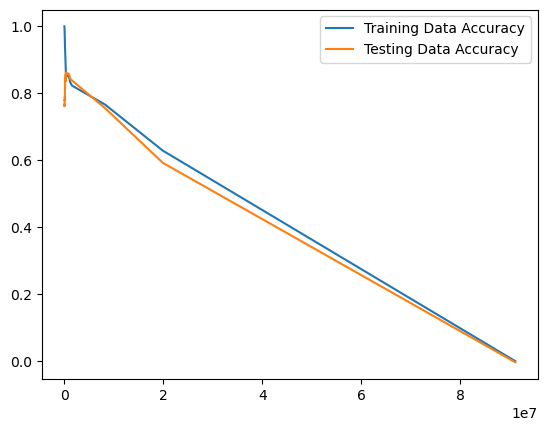

In [122]:
fig, ax = plt.subplots()
ax.plot(ccp_alpha_list, train_accuracy_list, label = "Training Data Accuracy")
ax.plot(ccp_alpha_list, test_accuracy_list, label = "Testing Data Accuracy")
ax.legend()
plt.show()

In [123]:
max_test = test_accuracy_list.index(max(test_accuracy_list))
max_test

860

In [124]:
best_ccp = ccp_alpha_list[max_test]
best_ccp

302093.58138724416

In [125]:
# Now fit the model on best ccp
dt_reg_ccp = DecisionTreeRegressor(ccp_alpha= best_ccp,random_state=2)

dt_reg_ccp.fit(x_train, y_train)

DecisionTreeRegressor(ccp_alpha=302093.58138724416, random_state=2)

In [126]:
# Training Accuracy
y_pred_train = dt_reg_ccp.predict(x_train)

mse = mean_squared_error(y_train, y_pred_train)
print("MSE :", mse)
print("*"*50)

rmse = np.sqrt(mse)
print("RMSE :", rmse)
print("*"*50)

mae = mean_absolute_error(y_train, y_pred_train)
print("MAE :", mae)
print("*"*50)

r2_train_ccp_dt_model = r2_score(y_train, y_pred_train)
print("R2 Score :", r2_train_ccp_dt_model)

MSE : 20346671.61421988
**************************************************
RMSE : 4510.728501497279
**************************************************
MAE : 2742.4350497319742
**************************************************
R2 Score : 0.8596278790408939


In [127]:
# Testing Accuracy
y_pred = dt_reg_ccp.predict(x_test)

mse = mean_squared_error(y_test, y_pred)
print("MSE :", mse)
print("*"*50)

rmse = np.sqrt(mse)
print("RMSE :", rmse)
print("*"*50)

mae = mean_absolute_error(y_test, y_pred)
print("MAE :", mae)
print("*"*50)

r2_test_ccp_dt_model = r2_score(y_test, y_pred)
print("R2 Score :", r2_test_ccp_dt_model)

MSE : 20877789.18572825
**************************************************
RMSE : 4569.221945334703
**************************************************
MAE : 2563.083034703586
**************************************************
R2 Score : 0.8616679417205779


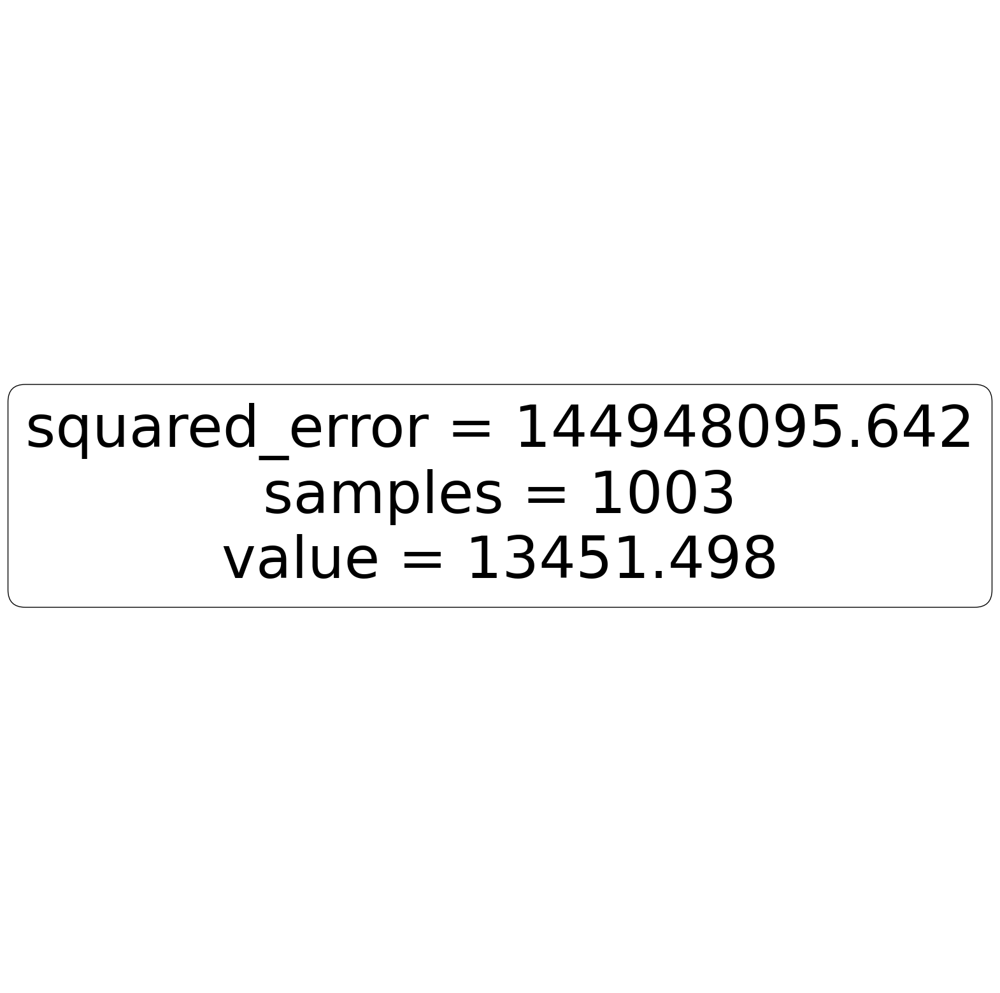

In [128]:
plt.figure(figsize=(20, 20))
plot_tree(decision_tree_model, feature_names=x.columns, filled=True, rounded=True, precision=3)
print()
plt.show()
plt.savefig("Decision Tree Regressor with Prunning.png")

### Feature Selection Techniques

In [129]:
array = dt_reg_ccp.feature_importances_
array

array([0.09893801, 0.        , 0.16224968, 0.00731789, 0.73149442,
       0.        , 0.        , 0.        , 0.        ])

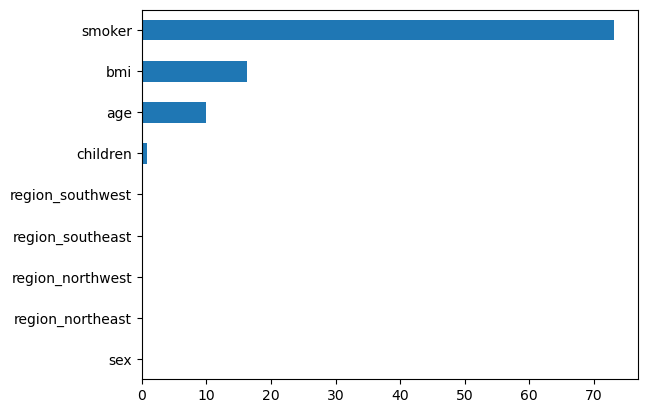

In [130]:
s1 = pd.Series(array * 100, index=x.columns)
s1.sort_values().plot(kind = "barh")
plt.show()

# Results Summary :

In [131]:
results_dt=pd.DataFrame(
{'Model':['Regular DT Model','gscv DT Model','Post Prunning DT Model'],
 'R2_Train':[r2_train_dt_model,r2_train_gscv_dt_model,r2_train_ccp_dt_model],
 'R2_Test':[r2_test_dt_model,r2_test_gscv_dt_model,r2_test_ccp_dt_model],
})
display(results_dt)

,Model,R2_Train,R2_Test
0,Regular DT Model,1.000000,0.765683
1,gscv DT Model,0.866826,0.866798
2,Post Prunning DT Model,0.859628,0.861668


# [4] Random Forest Algorithm

In [132]:
# creating instance & model fitting
rf_reg=RandomForestRegressor(random_state=15)

rf_reg.fit(x_train, y_train)

RandomForestRegressor(random_state=15)

### Model Evaluation of RF Regression

In [133]:
# Evaluation of Training Data
y_pred_train=rf_reg.predict(x_train)

mse=mean_squared_error(y_train,y_pred_train)
print("MSE=",mse)

rmse=np.sqrt(mse)
print("RMSE=",rmse)

mae=mean_absolute_error(y_train,y_pred_train)
print("MAE=",mae)

r2_train_rf_model=r2_score(y_train,y_pred_train)
print("R2 Score=",r2_train_rf_model)

MSE= 3255543.329831893
RMSE= 1804.3124257821573
MAE= 1000.2802085266499
R2 Score= 0.9775399372070568


In [134]:
# In RF training model is always overfitted.

In [135]:
# Evaluation of Testing Data
y_pred_test=rf_reg.predict(x_test)

mse=mean_squared_error(y_test,y_pred_test)
print("MSE=",mse)

rmse=np.sqrt(mse)
print("RMSE=",rmse)

mae=mean_absolute_error(y_test,y_pred_test)
print("MAE=",mae)

r2_test_rf_model=r2_score(y_test,y_pred_test)
print("R2 Score=",r2_test_rf_model)

MSE= 21980503.407706775
RMSE= 4688.336955435986
MAE= 2503.3042538196714
R2 Score= 0.8543615776863748


In [136]:
rf_reg.estimators_[1]

DecisionTreeRegressor(max_features='auto', random_state=1346817781)

In [137]:
plt.figure(figsize=(250, 250))
plot_tree(rf_reg.estimators_[1], feature_names=x.columns, filled=True, rounded=True, precision=2)
print()
plt.show()
plt.savefig("Random Forest Regressor.png")

# 6.2 Prunning Techniques

# 6.3 Hyperparameter Tunning (Pre-Prunning)

### 6.3.1 RandomizedSearchCV 

In [138]:
import time
t1 = time.time()

# Defined param_grid
param_grid = {"n_estimators" : np.arange(10,200),
                 "criterion":['squared_error', 'absolute_error'], 
                 "max_depth": np.arange(4,8),
                 "min_samples_split": np.arange(2,20),
                 "min_samples_leaf": np.arange(2,15), 
                 "max_features": ['sqrt', 'log2'],
                  "random_state": np.arange(1,14)
                 } 

# Create Instance & Model Fitting
rscv_rf_reg = RandomizedSearchCV(rf_reg, param_grid, cv=9, n_jobs=-1)
rscv_rf_reg.fit(x_train, y_train)

t2 = time.time()
print("Required Time :", t2-t1, "sec")

Required Time : 22.066709518432617 sec


In [139]:
# best parameters from gridsearchcv
rscv_rf_reg.best_params_

{'random_state': 13,
 'n_estimators': 162,
 'min_samples_split': 13,
 'min_samples_leaf': 6,
 'max_features': 'log2',
 'max_depth': 5,
 'criterion': 'squared_error'}

#### Model Evaluation of GridSearchCV

In [140]:
# Evaluation of Training Data
y_pred_train=rscv_rf_reg.predict(x_train)

mse=mean_squared_error(y_train,y_pred_train)
print("MSE=",mse)

rmse=np.sqrt(mse)
print("RMSE=",rmse)

mae=mean_absolute_error(y_train,y_pred_train)
print("MAE=",mae)

r2_train_rscv_rf_model=r2_score(y_train,y_pred_train)
print("R2 Score=",r2_train_rscv_rf_model)

MSE= 23765300.437004462
RMSE= 4874.966711373982
MAE= 3420.9309772698193
R2 Score= 0.8360426859574794


In [141]:
# Evaluation of Testing Data
y_pred_test=rscv_rf_reg.predict(x_test)

mse=mean_squared_error(y_test,y_pred_test)
print("MSE=",mse)

rmse=np.sqrt(mse)
print("RMSE=",rmse)

mae=mean_absolute_error(y_test,y_pred_test)
print("MAE=",mae)

r2_test_rscv_rf_model=r2_score(y_test,y_pred_test)
print("R2 Score=",r2_test_rscv_rf_model)

MSE= 29556789.852732677
RMSE= 5436.615661671577
MAE= 3635.862567221709
R2 Score= 0.8041626179818029


### Feature Selection Techniques

In [142]:
array = rscv_rf_reg.best_estimator_.feature_importances_
array

array([0.11647705, 0.00737829, 0.12052871, 0.0195179 , 0.72042914,
       0.00327796, 0.00291514, 0.00540546, 0.00407035])

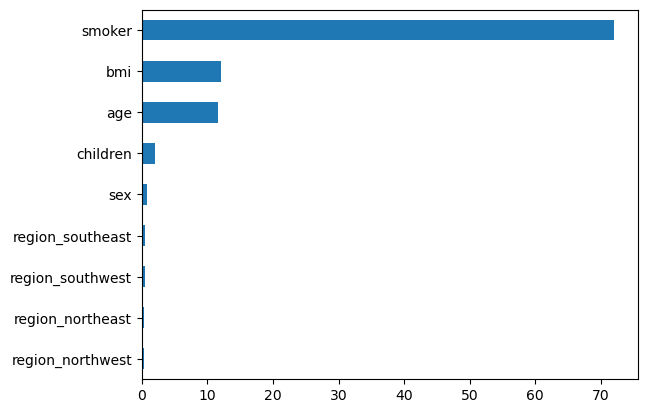

In [143]:
s1 = pd.Series(array * 100, index=x.columns)
s1.sort_values().plot(kind = "barh")
plt.show()

# Results Summary :

In [144]:
results_rf=pd.DataFrame(
{'Model':['Regular RF Model','rscv RF Model'],
 'R2_Train':[r2_train_rf_model,r2_train_rscv_rf_model],
 'R2_Test':[r2_test_rf_model,r2_test_rscv_rf_model],
})
display(results_rf)

,Model,R2_Train,R2_Test
0,Regular RF Model,0.977540,0.854362
1,rscv RF Model,0.836043,0.804163


# [5] AdaBoost Algorithm

In [145]:
# creating instance & model fitting
ada_reg=AdaBoostRegressor(random_state=15)

ada_reg.fit(x_train, y_train)

AdaBoostRegressor(random_state=15)

### Model Evaluation of RF Regression

In [146]:
# Evaluation of Training Data
y_pred_train=ada_reg.predict(x_train)

mse=mean_squared_error(y_train,y_pred_train)
print("MSE=",mse)

rmse=np.sqrt(mse)
print("RMSE=",rmse)

mae=mean_absolute_error(y_train,y_pred_train)
print("MAE=",mae)

r2_train_ada_model=r2_score(y_train,y_pred_train)
print("R2 Score=",r2_train_ada_model)

MSE= 24072662.622073427
RMSE= 4906.389978596629
MAE= 3845.0499768293566
R2 Score= 0.8339221876942351


In [147]:
# In RF training model is always overfitted.

In [148]:
# Evaluation of Testing Data
y_pred_test=ada_reg.predict(x_test)

mse=mean_squared_error(y_test,y_pred_test)
print("MSE=",mse)

rmse=np.sqrt(mse)
print("RMSE=",rmse)

mae=mean_absolute_error(y_test,y_pred_test)
print("MAE=",mae)

r2_test_ada_model=r2_score(y_test,y_pred_test)
print("R2 Score=",r2_test_ada_model)

MSE= 25712966.32654851
RMSE= 5070.795433316996
MAE= 3793.968546858876
R2 Score= 0.8296310243973346


# Hyperparameter Tunning (Pre-Prunning)

### RandomizedSearchCV 

In [149]:
import time
t1 = time.time()

# Defined param_grid
param_grid = {
            "n_estimators" : np.arange(10,200,2),
            "learning_rate" : np.arange(0,2,0.001)
                }

# Create Instance & Model Fitting
rscv_ada_reg = RandomizedSearchCV(ada_reg, param_grid, cv=9, n_jobs=-1)
rscv_ada_reg.fit(x_train, y_train)

t2 = time.time()
print("Required Time :", t2-t1, "sec")

Required Time : 1.0803720951080322 sec


In [150]:
# best parameters from gridsearchcv
rscv_ada_reg.best_params_

{'n_estimators': 136, 'learning_rate': 1.8960000000000001}

#### Model Evaluation of GridSearchCV

In [151]:
# Evaluation of Training Data
y_pred_train=rscv_ada_reg.predict(x_train)

mse=mean_squared_error(y_train,y_pred_train)
print("MSE=",mse)

rmse=np.sqrt(mse)
print("RMSE=",rmse)

mae=mean_absolute_error(y_train,y_pred_train)
print("MAE=",mae)

r2_train_rscv_ada_model=r2_score(y_train,y_pred_train)
print("R2 Score=",r2_train_rscv_ada_model)

MSE= 23136265.43005633
RMSE= 4810.017196440812
MAE= 2922.4549349303193
R2 Score= 0.8403824118722145


In [152]:
# Evaluation of Testing Data
y_pred_test=rscv_ada_reg.predict(x_test)

mse=mean_squared_error(y_test,y_pred_test)
print("MSE=",mse)

rmse=np.sqrt(mse)
print("RMSE=",rmse)

mae=mean_absolute_error(y_test,y_pred_test)
print("MAE=",mae)

r2_test_rscv_ada_model=r2_score(y_test,y_pred_test)
print("R2 Score=",r2_test_rscv_ada_model)

MSE= 21788333.79676623
RMSE= 4667.7975316808925
MAE= 2833.3058878168745
R2 Score= 0.8556348551193289


### Feature Selection Techniques

In [153]:
array = rscv_ada_reg.best_estimator_.feature_importances_
array

array([0.14186551, 0.        , 0.15538376, 0.02743897, 0.67338691,
       0.00192487, 0.        , 0.        , 0.        ])

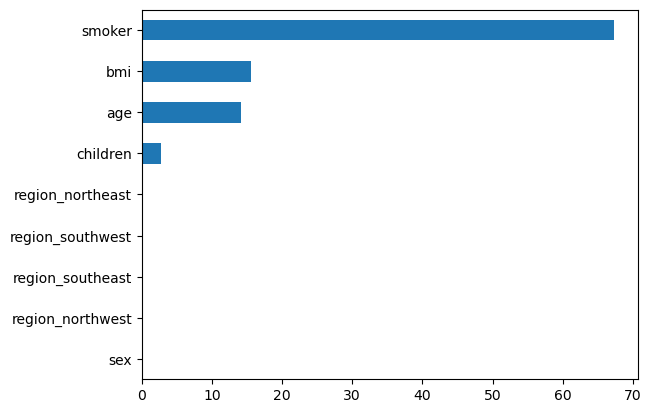

In [154]:
s1 = pd.Series(array * 100, index=x.columns)
s1.sort_values().plot(kind = "barh")
plt.show()

# Results Summary :

In [155]:
results_ada=pd.DataFrame(
{'Model':['Regular AdaBoost Model','rscv ada Model'],
 'R2_Train':[r2_train_ada_model,r2_train_rscv_ada_model],
 'R2_Test':[r2_test_ada_model,r2_test_rscv_ada_model],
})
display(results_ada)

,Model,R2_Train,R2_Test
0,Regular AdaBoost Model,0.833922,0.829631
1,rscv ada Model,0.840382,0.855635


In [156]:
result=pd.concat([results_linear,results_knn,results_dt,results_rf,results_ada],axis=0,ignore_index=True)
result['% Diff.']=(result['R2_Train']-result['R2_Test'])*100
result

,Model,R2_Train,R2_Test,% Diff.
0,Linear Regression,0.737941,0.787479,-4.953818
1,Ridge Regression,0.737919,0.787268,-4.934961
2,Lasso Regression,0.737941,0.787461,-4.951998
3,gscv Ridge Regression,0.737816,0.786910,-4.909369
4,gscv Lasso Regression,0.737940,0.787426,-4.948606
5,Regular KNN Model,0.407317,0.153683,25.363378
6,Std Model,0.734257,0.734257,0.000000
7,Normal Model,0.746017,0.746017,0.000000
8,gscv std Model,0.827050,0.784218,4.283249
9,gscv normal Model,0.817401,0.746002,7.139892


### Storring the feature names, label encoded values in JSON file

In [157]:
feature_names = x.columns
sex_value={'female': 0, 'male': 1}
smoker_value={'no': 0, 'yes': 1}

json_data = {"sex":sex_value, 
             "smoker":smoker_value,
             "columns":list(feature_names)}

with open("Project_data.json", "w") as f:
    json.dump(json_data, f)

### Storring fitted model in pickle file

In [158]:
#fitted model
with open("model.pkl", "wb") as f:
    pickle.dump(gscv_dt_reg, f)
    
#fitted related scalling term
with open("scaler term.pkl", "wb") as f:
    pickle.dump(std_scaler, f)

# Prediction on User entered value for testing

### loading models

In [159]:
with open("Project_data.json", "r") as f:
    json_data=json.load(f)

#fitted model
with open("model.pkl", "rb") as f:
    model=pickle.load(f)

#fitted scalling term
with open("scaler term.pkl", "rb") as f:
    std_scaler=pickle.load(f)

In [160]:
age = 26.0
sex = "male"
bmi = 28.6
children = 1.0
smoker = "no"      
region = "northeast"

## if model==KNN Model:
#     # conversion of scaled variables
#     age=std_scaler.transform([[age,bmi]])[0][0]
#     bmi=std_scaler.transform([[age,bmi]])[0][1]

### conversion for One-Hot Encoded values

In [161]:
# input for one-hot encodding
region = "region_" + region

# index of one-hot encodded columns
region_index = np.where(feature_names == region)[0][0]
# or
region_index = list(feature_names).index(region)

### Creating array of user input values

In [162]:
test_array = np.zeros(len(feature_names))

# Note: put feature values in front of correct feature index
test_array[0] = age
test_array[1] = json_data['sex'][sex]     #label encodded
test_array[2] = bmi
test_array[3] = children
test_array[4] = json_data['smoker'][smoker]  #label encodded
test_array[region_index] = 1   # one-hot encodded

test_array

array([26. ,  1. , 28.6,  1. ,  0. ,  1. ,  0. ,  0. ,  0. ])

## Prediction Output

In [164]:
charges = model.predict([test_array])[0]

print("Predicted Medical Insurance Charges is:",round(charges,2),'/- Rs.')

Predicted Medical Insurance Charges is: 8705.67 /- Rs.
